2024-04-28 17:38:40.543446: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-28 17:38:40.543515: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-28 17:38:40.544600: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-28 17:38:41.556224: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Some of the weights of FlaxCLIPTextModel were initialized in bfloat16 precision from the model checkpoint at ./instruct-pix2pix-model/text_encoder:
[('text_model', 'embeddings', 'position_embedding', 'embedding'), ('text_model', 'embeddings'

n-steps: 50, guidance_scale: 7.5, image_guidance_scale: 1.5
Running prompt 0
Running prompt 1
Running prompt 2
Running prompt 3
Running prompt 4
Running prompt 5
Running prompt 6


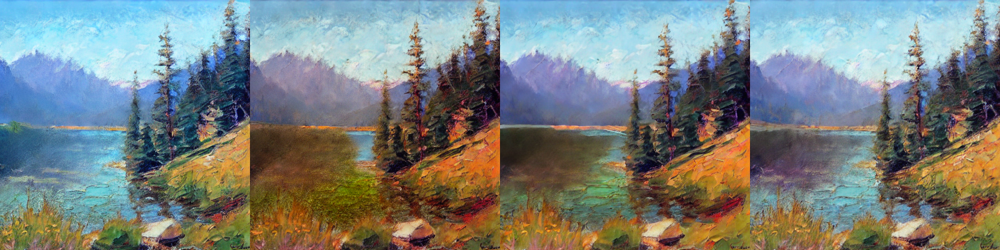

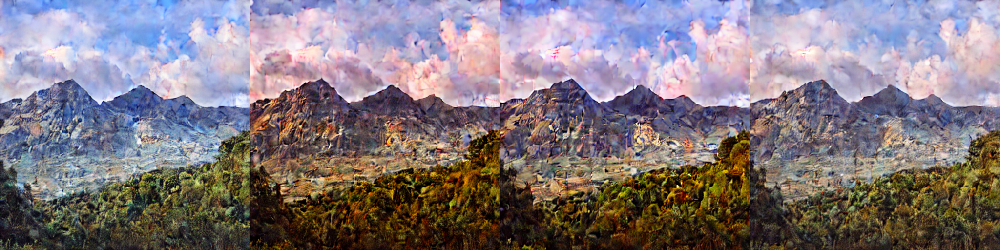

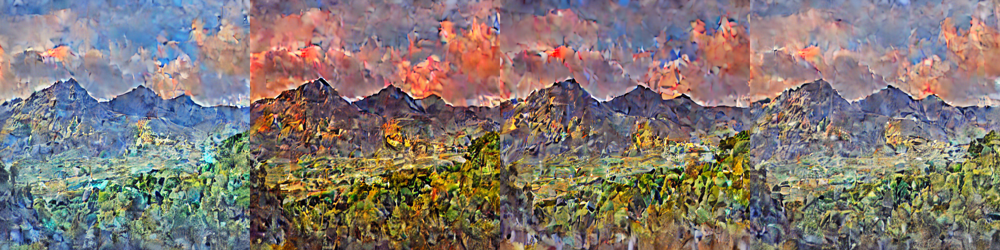

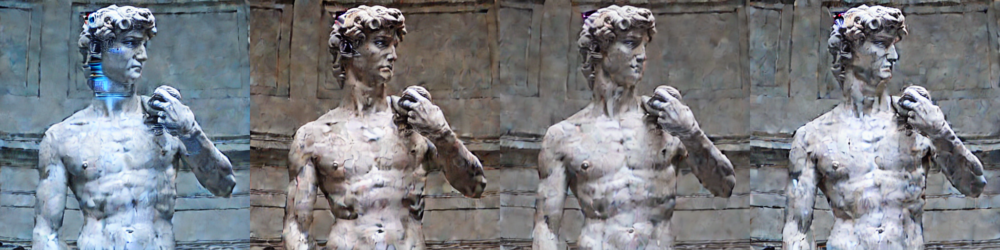

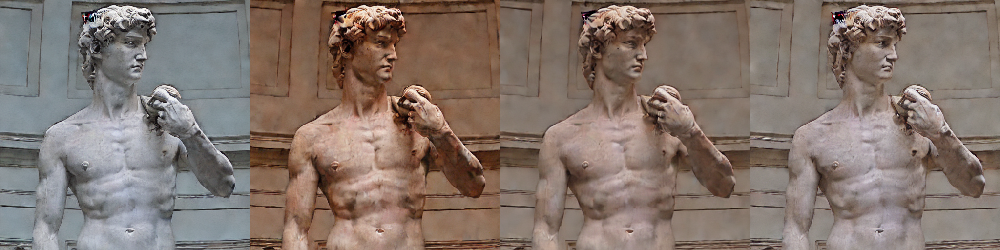

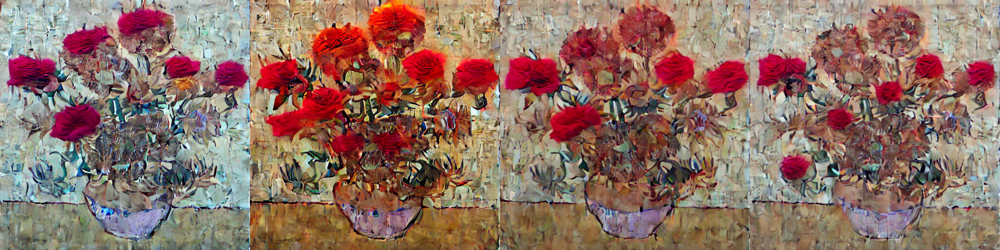

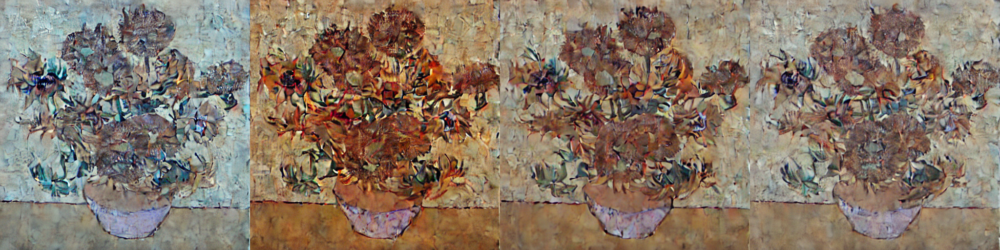

In [1]:
import requests
from io import BytesIO
from PIL import Image
import jax
import numpy as np
import jax.numpy as jnp
from flax.jax_utils import replicate
from flax.training.common_utils import shard
from  flax.serialization import to_bytes, from_bytes
from flax.core.frozen_dict import FrozenDict, unfreeze, freeze
from diffusers.utils import make_image_grid
from diffusers import (
    FlaxStableDiffusionImg2ImgPipeline,
    FlaxStableDiffusionInstructPix2PixPipeline,
    FlaxStableDiffusionImg2ImgPipeline
)

from jax.experimental.compilation_cache import compilation_cache as cc
cc.set_cache_dir("/tmp/sd_cache")

def download_image(url):
    response = requests.get(url)
    return Image.open(BytesIO(response.content)).convert("RGB")

def create_key(seed=0):
    return jax.random.PRNGKey(seed)

pipeline, pipeline_params = FlaxStableDiffusionInstructPix2PixPipeline.from_pretrained(
    # '../flax_models/instruct-pix2pix',
    # '../flax_models/stable-diffusion-v1-5',
    './instruct-pix2pix-model', 
    dtype=jnp.bfloat16,
    safety_checker=None
)

LOAD_NON_EMA_PARAMS = False # change if testing non-ema params

if LOAD_NON_EMA_PARAMS:
    params_path = './instruct-pix2pix-model/unet/non_ema.msgpack'

    # Load the EMA parameters from disk
    with open(params_path, 'rb') as f:
        non_ema_params = from_bytes(pipeline_params['unet'], f.read()) # template object (here params['unet']) needs to be isomorphic to the target object

    # Optionally, remove the 'unet' key from the pipeline parameters
    popped_item = pipeline_params.pop('unet', None)

    # Update the pipeline params 
    pipeline_params['non_ema'] = non_ema_params

    # Otherwise, only the EMA parameters are saved to disk under the 'unet' key in the params dictionary


rng = create_key(1371)
num_samples = jax.device_count()
rng = jax.random.split(rng, jax.device_count())
p_params = replicate(pipeline_params)

NUM_INFERENCE_STEPS     = 50
GUIDANCE_SCALE          = 7.5
IMAGE_GUIDANCE_SCALE    = 1.5

def run_pipeline(prompt, image):
    prompt_ids, processed_image = pipeline.prepare_inputs(
        prompt=[prompt] * num_samples, image=[image] * num_samples
    )

    prompt_ids = shard(prompt_ids)
    processed_image = shard(processed_image)
    
    output = pipeline(
        prompt_ids=prompt_ids,
        image=processed_image,
        params=p_params,
        prng_seed=rng,
        num_inference_steps=NUM_INFERENCE_STEPS,
        guidance_scale=GUIDANCE_SCALE,
        image_guidance_scale=IMAGE_GUIDANCE_SCALE,
        height=512,
        width=512,
        jit=True, # include for img2img
    ).images

    output_images = pipeline.numpy_to_pil(np.asarray(output.reshape((num_samples,) + output.shape[-3:])))

    # Grid plot images
    return make_image_grid(output_images, rows=len(output_images)//4, cols=4)


# Run pipeline with multiple prompts and images

text_prompts = [
    "wipe out the lake",
    "make the mountains snowy",
    "Generate a cartoonized version of the image",
    "turn him into a cyborg",
    "Generate a cartoonized version of the image",
    "Swap sunflowers with roses",
    "Generate a cartoonized version of the image",
]
urls = [
    "https://huggingface.co/datasets/sayakpaul/sample-datasets/resolve/main/test_pix2pix_4.png",
    "https://huggingface.co/datasets/diffusers/diffusers-images-docs/resolve/main/mountain.png",
    "https://huggingface.co/datasets/diffusers/diffusers-images-docs/resolve/main/mountain.png",
    "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg",
    "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg",
    "https://wehco.media.clients.ellingtoncms.com/img/photos/2019/06/25/vangogh1_t800.png?90232451fbcadccc64a17de7521d859a8f88077d",
    "https://wehco.media.clients.ellingtoncms.com/img/photos/2019/06/25/vangogh1_t800.png?90232451fbcadccc64a17de7521d859a8f88077d",
]

image_prompts = list(map(lambda x : download_image(x).resize((512,512)), urls))
images = []

print(f'n-steps: {NUM_INFERENCE_STEPS}, guidance_scale: {GUIDANCE_SCALE}, image_guidance_scale: {IMAGE_GUIDANCE_SCALE}')

for i in range(len(text_prompts)):
    print(f"Running prompt {i}")
    images.append(run_pipeline(text_prompts[i], image_prompts[i]))

for i in range(len(images)):
    images[i].show()
    




# # %% 
# # Manual testing 


# M, N = 1, 2 # text, image

# run_pipeline(text_prompts[M], image_prompts[N])

# # %%

# # Inference with pretrained model from Hugging Face

# import torch  
# from diffusers import StableDiffusionInstructPix2PixPipeline
# from diffusers import FlaxStableDiffusionInstructPix2PixPipeline

# model_id = 'timbrooks/instruct-pix2pix'
# image = Image.open(BytesIO(requests.get(
#     'https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg'
#     ).content)).convert('RGB')

# prompt='turn him into a cyborg'

# pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(
#     model_id, 
#     torch_dtype=torch.float32, #torch.float16 not supported
#     safety_checker=None
# )

# images = pipe(prompt, image=image).images
# images[0].show()